## 3.5 LightGBM Geospatial Modelling

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import copy

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd
import pyproj
import plotly.express as px

import lightgbm as lgb
import optuna
from sklearn.metrics import mean_squared_error

import warnings
warnings.filterwarnings("ignore")

SMAPE_ENABLED = True
LAGS = [1, 2, 3, 4, 5, 6, 7, 8]

In [2]:
#Read clusters_with_subzones.csv file
clusters_with_subzones = pd.read_csv("../dataset/clusters_with_subzones.csv")
clusters_with_subzones.head()

,Number Of Cases,Cluster Number,Recent Cases In Cluster,Date,OBJECTID,SUBZONE_N,PLN_AREA_N,REGION_N,geometry
0,2.0,50.0,2.0,160503,1,PEOPLE'S PARK,OUTRAM,CENTRAL REGION,POLYGON ((103.84319371624179 1.284328389411806...
1,2.0,49.0,2.0,151109,2,BUKIT MERAH,BUKIT MERAH,CENTRAL REGION,POLYGON ((103.82208767714161 1.280494489593270...
2,1.0,5.0,2.0,170116,3,CHINATOWN,OUTRAM,CENTRAL REGION,POLYGON ((103.8437524275464 1.2850793817397896...
3,1.0,5.0,2.0,170116,3,CHINATOWN,OUTRAM,CENTRAL REGION,POLYGON ((103.8437524275464 1.2850793817397896...
4,2.0,5.0,2.0,170116,3,CHINATOWN,OUTRAM,CENTRAL REGION,POLYGON ((103.8437524275464 1.2850793817397896...


In [3]:
clusters_with_subzones.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20258 entries, 0 to 20257
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Number Of Cases          20258 non-null  float64
 1   Cluster Number           20258 non-null  float64
 2   Recent Cases In Cluster  20258 non-null  float64
 3   Date                     20258 non-null  int64  
 4   OBJECTID                 20258 non-null  int64  
 5   SUBZONE_N                20258 non-null  object 
 6   PLN_AREA_N               20258 non-null  object 
 7   REGION_N                 20258 non-null  object 
 8   geometry                 20258 non-null  object 
dtypes: float64(3), int64(2), object(4)
memory usage: 1.4+ MB


In [4]:
#Convert the datatype of 'Date' to datetime
clusters_with_subzones['Date']= clusters_with_subzones['Date'].map(lambda x: '20'+str(x))
clusters_with_subzones['Date']=pd.to_datetime(clusters_with_subzones['Date'])

In [5]:
#Aggregate the dengue cases by date and subzones
df_all = clusters_with_subzones.groupby(by=['Date','OBJECTID'],as_index=False)[['Number Of Cases','Recent Cases In Cluster']].sum()

In [6]:
#Read Singapore subzones geo data
sg = gpd.read_file("../dataset/MP14_SUBZONE_NO_SEA_PL/MP14_SUBZONE_NO_SEA_PL.shp")

In [7]:
sg.to_crs(pyproj.CRS.from_epsg(4326), inplace=True)

In [8]:
#Merge the aggregated dengue cases data with subzones geo data
df_sg = sg[['OBJECTID','SUBZONE_N','PLN_AREA_N','REGION_N']]
df_all = df_all.merge(df_sg,how='left',on='OBJECTID')

In [9]:
df_all.isnull().sum()

Date                       0
OBJECTID                   0
Number Of Cases            0
Recent Cases In Cluster    0
SUBZONE_N                  0
PLN_AREA_N                 0
REGION_N                   0
dtype: int64

In [10]:
df_all.head()

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
0,2015-07-03,21,2.0,2.0,EVERTON PARK,BUKIT MERAH,CENTRAL REGION
1,2015-07-03,25,2.0,2.0,KAMPONG TIONG BAHRU,BUKIT MERAH,CENTRAL REGION
2,2015-07-03,52,2.0,1.0,MARGARET DRIVE,QUEENSTOWN,CENTRAL REGION
3,2015-07-03,79,2.0,4.0,CHATSWORTH,TANGLIN,CENTRAL REGION
4,2015-07-03,100,4.0,9.0,GHIM MOH,QUEENSTOWN,CENTRAL REGION


In [11]:
df_all.shape

(4181, 7)

## Define variables and functions

In [12]:
date_col = 'Date'
cat_cols = ['SUBZONE_N','PLN_AREA_N','REGION_N']
target = 'Number Of Cases'

In [13]:
def to_percent(X, y):
    yhat = y / X['lags(1)']
    yhat[X['lags(1)'] == 0] = 0 # denominator cannot be 0
    return yhat

def from_percent(X, y):
    yhat = y * X[f'lags(1)']
    return yhat

In [14]:
def smape(y_true, y_pred):
    smap = np.zeros(len(y_true))
    
    num = np.abs(y_true - y_pred)
    dem = ((np.abs(y_true) + np.abs(y_pred)) / 2)
    
    pos_ind = (y_true != 0) | (y_pred != 0)
    smap[pos_ind] = num[pos_ind] / dem[pos_ind]
    
    return 100 * np.mean(smap)

In [15]:
def lgb_objective(trial):
    params = {
        'n_iter'           : 200,
        'verbosity'        : -1,
        'objective'        : 'l1',
        'random_state'     : 42,
        'extra_trees'      : True,
        'colsample_bytree' : trial.suggest_float('colsample_bytree', 0.1, 1.0),
        'colsample_bynode' : trial.suggest_float('colsample_bynode', 0.1, 1.0),
        'max_depth'        : trial.suggest_int('max_depth', 3, 10),
        'learning_rate'    : trial.suggest_float('learning_rate', 0.01, 0.1, log=True),
        'lambda_l1'        : trial.suggest_float('lambda_l1', 1e-2, 10.0),
        'lambda_l2'        : trial.suggest_float('lambda_l2', 1e-2, 10.0),
        'num_leaves'       : trial.suggest_int('num_leaves', 8, 1024),
        'min_data_in_leaf' : trial.suggest_int('min_data_in_leaf', 5, 250),}
    
    model  = lgb.LGBMRegressor(**params)
    X, y   = df_all.drop(columns=[target]), df_all[target]
    
    train_times = list(range(scale_last))
    valid_times = [scale_last]
    
    y_train = y[X['scale'].isin(train_times)]
    y_valid = y[X['scale'].isin(valid_times)]
    
    X_train = X[X['scale'].isin(train_times)]
    X_valid = X[X['scale'].isin(valid_times)]
    
    if SMAPE_ENABLED:
        y_train = to_percent(X_train, y_train)
    
    model.fit(X_train, y_train)
    y_pred = model.predict(X_valid)
    
    if SMAPE_ENABLED:
        y_pred = from_percent(X_valid, y_pred)
    
    return smape(y_valid, y_pred)

## Train/Test split

In [16]:
#Check how many weeks of data that we have in total
len(df_all[date_col].unique())

187

In [17]:
#Take 80% of the weeks as train data, the rest 20% as test data 
187*0.8

149.6

In [18]:
#Check the end date of train data
df_all[date_col].unique()[149]

numpy.datetime64('2018-04-16T00:00:00.000000000')

In [19]:
#Check the start date of test data
df_all[date_col].unique()[150]

numpy.datetime64('2018-04-23T00:00:00.000000000')

In [20]:
#Train / Test split
df_train = df_all[df_all[date_col]<'2018-04-23']
df_test = df_all[df_all[date_col]>'2018-04-16']

In [21]:
#Backup the test data
df_test_copy = copy.deepcopy(df_test)
df_test_copy

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
3790,2018-04-23,14,1.0,1.0,HENDERSON HILL,BUKIT MERAH,CENTRAL REGION
3791,2018-04-23,15,2.0,2.0,REDHILL,BUKIT MERAH,CENTRAL REGION
3792,2018-04-23,117,3.0,9.0,ALJUNIED,GEYLANG,CENTRAL REGION
3793,2018-04-23,121,4.0,2.0,FRANKEL,BEDOK,EAST REGION
3794,2018-04-23,135,4.0,2.0,GEYLANG EAST,GEYLANG,CENTRAL REGION
...,...,...,...,...,...,...,...
4176,2018-12-31,234,3.0,6.0,YIO CHU KANG WEST,ANG MO KIO,NORTH-EAST REGION
4177,2018-12-31,252,2.0,4.0,LORONG AH SOO,HOUGANG,NORTH-EAST REGION
4178,2018-12-31,274,4.0,8.0,YISHUN WEST,YISHUN,NORTH REGION
4179,2018-12-31,280,3.0,4.0,MIDVIEW,WOODLANDS,NORTH REGION


In [22]:
#Replace the target column in test data with null value
df_test[target] = np.nan

In [23]:
#Backup the test data with null target value
df_test_2 = copy.deepcopy(df_test)

In [24]:
#Combine the train data with the test data with null target value
df_all = pd.concat([df_train, df_test], axis=0)

## Predict the first week of test data

### Time features

In [25]:
df_all['year'] = df_all[date_col].dt.year
df_all['month'] = df_all[date_col].dt.month
df_all['scale'] = (df_all[date_col] - df_all[date_col].min()).dt.days
df_all['scale'] = df_all['scale'].factorize()[0]

In [26]:
df_all

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N,year,month,scale
0,2015-07-03,21,2.0,2.0,EVERTON PARK,BUKIT MERAH,CENTRAL REGION,2015,7,0
1,2015-07-03,25,2.0,2.0,KAMPONG TIONG BAHRU,BUKIT MERAH,CENTRAL REGION,2015,7,0
2,2015-07-03,52,2.0,1.0,MARGARET DRIVE,QUEENSTOWN,CENTRAL REGION,2015,7,0
3,2015-07-03,79,2.0,4.0,CHATSWORTH,TANGLIN,CENTRAL REGION,2015,7,0
4,2015-07-03,100,4.0,9.0,GHIM MOH,QUEENSTOWN,CENTRAL REGION,2015,7,0
...,...,...,...,...,...,...,...,...,...,...
4176,2018-12-31,234,NaN,6.0,YIO CHU KANG WEST,ANG MO KIO,NORTH-EAST REGION,2018,12,186
4177,2018-12-31,252,NaN,4.0,LORONG AH SOO,HOUGANG,NORTH-EAST REGION,2018,12,186
4178,2018-12-31,274,NaN,8.0,YISHUN WEST,YISHUN,NORTH REGION,2018,12,186
4179,2018-12-31,280,NaN,4.0,MIDVIEW,WOODLANDS,NORTH REGION,2018,12,186


In [27]:
#Check the scale value of the start date of test data
scale_start_test = df_all[df_all[date_col]=='2018-04-23']['scale']
scale_start_test

3790    150
3791    150
3792    150
3793    150
3794    150
3795    150
3796    150
3797    150
3798    150
Name: scale, dtype: int64

In [28]:
scale_start_test = scale_start_test[3790]

### Lag features

In [29]:
for i in LAGS:
    df_all[f'lags({i})'] = df_all.groupby('OBJECTID')[target].shift(i)

### Categorical features

In [30]:
df_all = df_all.drop(columns=[date_col])
df_all[cat_cols] = df_all[cat_cols].astype('category')

### First week of the train data not used

In [31]:
df_all = df_all[df_all['scale'] != 0]

In [32]:
df_all.isnull().sum()

OBJECTID                      0
Number Of Cases             391
Recent Cases In Cluster       0
SUBZONE_N                     0
PLN_AREA_N                    0
REGION_N                      0
year                          0
month                         0
scale                         0
lags(1)                     480
lags(2)                     611
lags(3)                     743
lags(4)                     867
lags(5)                     999
lags(6)                    1125
lags(7)                    1244
lags(8)                    1357
dtype: int64

In [33]:
for i in LAGS:
    df_all[f'lags({i})'].fillna(0,inplace=True)

In [34]:
df_all

,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N,year,month,scale,lags(1),lags(2),lags(3),lags(4),lags(5),lags(6),lags(7),lags(8)
33,65,2.0,4.0,LITTLE INDIA,ROCHOR,CENTRAL REGION,2015,7,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
34,95,2.0,4.0,FARRER PARK,ROCHOR,CENTRAL REGION,2015,7,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
35,110,2.0,1.0,FARRER COURT,BUKIT TIMAH,CENTRAL REGION,2015,7,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
36,117,3.0,4.0,ALJUNIED,GEYLANG,CENTRAL REGION,2015,7,1,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
37,121,6.0,8.0,FRANKEL,BEDOK,EAST REGION,2015,7,1,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4176,234,NaN,6.0,YIO CHU KANG WEST,ANG MO KIO,NORTH-EAST REGION,2018,12,186,0.0,0.0,2.0,3.0,6.0,4.0,3.0,3.0
4177,252,NaN,4.0,LORONG AH SOO,HOUGANG,NORTH-EAST REGION,2018,12,186,0.0,0.0,0.0,1.0,1.0,2.0,2.0,2.0
4178,274,NaN,8.0,YISHUN WEST,YISHUN,NORTH REGION,2018,12,186,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4179,280,NaN,4.0,MIDVIEW,WOODLANDS,NORTH REGION,2018,12,186,0.0,0.0,0.0,3.0,2.0,2.0,2.0,25.0


### Hyperparameter optimization

In [35]:
#The last scale value of the train data is scale_start_test - 1
scale_last = scale_start_test-1

In [36]:
study = optuna.create_study(direction='minimize', study_name='Regressor')
study.optimize(lgb_objective, n_trials=30, show_progress_bar=True)

[I 2023-04-25 00:40:57,151] A new study created in memory with name: Regressor


  0%|          | 0/30 [00:00<?, ?it/s]

[LightGBM] [Warning] lambda_l1 is set=6.624312799660192, reg_alpha=0.0 will be ignored. Current value: lambda_l1=6.624312799660192
[LightGBM] [Warning] lambda_l2 is set=4.0740162363464885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.0740162363464885
[LightGBM] [Warning] min_data_in_leaf is set=211, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=211
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200
[I 2023-04-25 00:40:57,339] Trial 0 finished with value: 31.628008420186436 and parameters: {'colsample_bytree': 0.5591486478455481, 'colsample_bynode': 0.9211632872050587, 'max_depth': 4, 'learning_rate': 0.08259560116999894, 'lambda_l1': 6.624312799660192, 'lambda_l2': 4.0740162363464885, 'num_leaves': 137, 'min_data_in_leaf': 211}. Best is trial 0 with value: 31.628008420186436.
[LightGBM] [Warning] lambda_l1 is set=1.4171736655585951, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.

### Hyperparameter optimized model

In [37]:
study.best_value

26.81090282742291

In [38]:
study.best_params

{'colsample_bytree': 0.8433727778490476,
 'colsample_bynode': 0.879348003067243,
 'max_depth': 4,
 'learning_rate': 0.09594501139628539,
 'lambda_l1': 5.550126717627069,
 'lambda_l2': 7.190270531223499,
 'num_leaves': 714,
 'min_data_in_leaf': 148}

In [39]:
#Take the best params for the prediction (Note that the best params may vary between each run of the notebook)
params = {
    'n_iter': 200,
    'verbosity': -1,
    'objective': 'l1',
    'random_state': 42,
    'extra_trees': True,
    'colsample_bytree': 0.8758334301441368,
    'colsample_bynode': 0.704100655414444,
    'max_depth': 3,
    'learning_rate': 0.08065257962089115,
    'lambda_l1': 2.1551170674186366,
    'lambda_l2': 6.968482118774494,
    'num_leaves': 800,
    'min_data_in_leaf': 5}

model = lgb.LGBMRegressor(**params)

### Prediction

In [40]:
X, y   = df_all.drop(columns=[target]), df_all[target]
X_test, y_test = X[y.isnull()], y[y.isnull()]

train_times = list(range(scale_last))

X_train = X[X['scale'].isin(train_times)]
y_train = y[X['scale'].isin(train_times)]

if SMAPE_ENABLED:
    y_train = to_percent(X_train, y_train)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)

if SMAPE_ENABLED:
    y_pred = from_percent(X_test, y_pred)
    
df_test.loc[y_pred.index, target] = y_pred

[LightGBM] [Warning] lambda_l1 is set=2.1551170674186366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1551170674186366
[LightGBM] [Warning] lambda_l2 is set=6.968482118774494, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.968482118774494
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200


### Swap bad prediction with last value

In [41]:
X, y   = df_all.drop(columns=[target]), df_all[target]
valid_times = list(range(scale_start_test-45, scale_start_test)) #Take 30% of train data as valid weeks
results = []

for valid_time in valid_times:
    train_times = list(range(valid_time))
    
    X_train = X[X['scale'].isin(train_times)]
    X_valid = X[X['scale'].isin([valid_time])]

    y_train = y[X['scale'].isin(train_times)]
    y_valid = y[X['scale'].isin([valid_time])]
    
    if SMAPE_ENABLED:
        y_train = to_percent(X_train, y_train)

    model.fit(X_train, y_train)
    y_pred = model.predict(X_valid)

    if SMAPE_ENABLED:
        y_pred = from_percent(X_valid, y_pred)
        
    X_valid['y_true'] = y_valid
    X_valid['y_base'] = X_valid['lags(1)']
    X_valid['y_pred'] = y_pred
    
    results.append(X_valid[['scale', 'month', 'SUBZONE_N','PLN_AREA_N','REGION_N', 'OBJECTID', 'y_true', 'y_base', 'y_pred']])
    
df_record = pd.concat(results, axis=0)
df_record.head()

[LightGBM] [Warning] lambda_l1 is set=2.1551170674186366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1551170674186366
[LightGBM] [Warning] lambda_l2 is set=6.968482118774494, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.968482118774494
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200
[LightGBM] [Warning] lambda_l1 is set=2.1551170674186366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.1551170674186366
[LightGBM] [Warning] lambda_l2 is set=6.968482118774494, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.968482118774494
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200
[LightGBM]

,scale,month,SUBZONE_N,PLN_AREA_N,REGION_N,OBJECTID,y_true,y_base,y_pred
3517,105,6,TANJONG PAGAR,DOWNTOWN CORE,CENTRAL REGION,20,2.0,2.0,1.938502
3518,105,6,KEMBANGAN,BEDOK,EAST REGION,92,14.0,11.0,10.117216
3519,105,6,TEBAN GARDENS,JURONG EAST,WEST REGION,136,14.0,4.0,7.157370
3520,105,6,TAMPINES EAST,TAMPINES,EAST REGION,142,2.0,2.0,2.022530
3521,105,6,TAMAN JURONG,JURONG WEST,WEST REGION,189,4.0,2.0,2.506472


In [42]:
base_err = df_record.groupby('OBJECTID').apply(lambda x: smape(x.y_true, x.y_base))
pred_err = df_record.groupby('OBJECTID').apply(lambda x: smape(x.y_true, x.y_pred))

blacklist = base_err[(base_err + 1e-3) < pred_err].index

print(f'Avg SMAPE(model): {pred_err.mean():.3f}')
print(f'Avg SMAPE(base): {base_err.mean():.3f}')
print(len(blacklist))

Avg SMAPE(model): 33.155
Avg SMAPE(base): 35.196
42


In [43]:
idx = df_test[df_test['OBJECTID'].isin(blacklist)].index

df_test.loc[idx, target] = df_all.loc[idx, 'lags(1)']

In [44]:
df_test

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
3790,2018-04-23,14,2.000000,1.0,HENDERSON HILL,BUKIT MERAH,CENTRAL REGION
3791,2018-04-23,15,2.000000,2.0,REDHILL,BUKIT MERAH,CENTRAL REGION
3792,2018-04-23,117,2.767476,9.0,ALJUNIED,GEYLANG,CENTRAL REGION
3793,2018-04-23,121,3.000000,2.0,FRANKEL,BEDOK,EAST REGION
3794,2018-04-23,135,5.072390,2.0,GEYLANG EAST,GEYLANG,CENTRAL REGION
...,...,...,...,...,...,...,...
4176,2018-12-31,234,0.000000,6.0,YIO CHU KANG WEST,ANG MO KIO,NORTH-EAST REGION
4177,2018-12-31,252,0.000000,4.0,LORONG AH SOO,HOUGANG,NORTH-EAST REGION
4178,2018-12-31,274,0.000000,8.0,YISHUN WEST,YISHUN,NORTH REGION
4179,2018-12-31,280,0.000000,4.0,MIDVIEW,WOODLANDS,NORTH REGION


### Result Analysis

In [45]:
apply_func = lambda x: pd.Series([smape(x.y_true, x.y_base), smape(x.y_true, x.y_pred)])

#### SMAPE by timeline (scale)

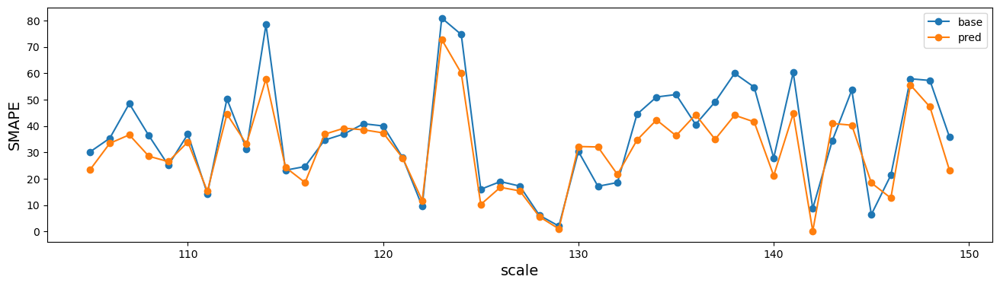

In [46]:
compare_by = 'scale'
data = df_record.groupby(compare_by).apply(apply_func)

plt.figure(figsize=(16, 4))
plt.xlabel(compare_by, fontsize=14)
plt.ylabel('SMAPE', fontsize=14)
plt.plot(data, marker='o')
plt.legend(['base', 'pred'])
plt.show()

*Interpretation: When comparing the SMAPE value of our predictions to the baseline lag(1), we observe that our prediction has a lower SMAPE value than the baseline for most weeks. However, the range of SMAPE values varies widely, ranging from 0% to 74%.* 

#### Geographic analysis

In [47]:
date_1_pred = df_test[df_test['Date']=='2018-04-23']
date_1_pred

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
3790,2018-04-23,14,2.000000,1.0,HENDERSON HILL,BUKIT MERAH,CENTRAL REGION
3791,2018-04-23,15,2.000000,2.0,REDHILL,BUKIT MERAH,CENTRAL REGION
3792,2018-04-23,117,2.767476,9.0,ALJUNIED,GEYLANG,CENTRAL REGION
3793,2018-04-23,121,3.000000,2.0,FRANKEL,BEDOK,EAST REGION
3794,2018-04-23,135,5.072390,2.0,GEYLANG EAST,GEYLANG,CENTRAL REGION
3795,2018-04-23,160,16.442773,61.0,YUNNAN,JURONG WEST,WEST REGION
3796,2018-04-23,173,18.367027,25.0,BEDOK NORTH,BEDOK,EAST REGION
3797,2018-04-23,181,5.006327,9.0,BALESTIER,NOVENA,CENTRAL REGION
3798,2018-04-23,209,5.263494,1.0,DAIRY FARM,BUKIT PANJANG,WEST REGION


In [48]:
date_1_true = df_test_copy[df_test_copy['Date']=='2018-04-23']
date_1_true

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
3790,2018-04-23,14,1.0,1.0,HENDERSON HILL,BUKIT MERAH,CENTRAL REGION
3791,2018-04-23,15,2.0,2.0,REDHILL,BUKIT MERAH,CENTRAL REGION
3792,2018-04-23,117,3.0,9.0,ALJUNIED,GEYLANG,CENTRAL REGION
3793,2018-04-23,121,4.0,2.0,FRANKEL,BEDOK,EAST REGION
3794,2018-04-23,135,4.0,2.0,GEYLANG EAST,GEYLANG,CENTRAL REGION
3795,2018-04-23,160,22.0,61.0,YUNNAN,JURONG WEST,WEST REGION
3796,2018-04-23,173,20.0,25.0,BEDOK NORTH,BEDOK,EAST REGION
3797,2018-04-23,181,8.0,9.0,BALESTIER,NOVENA,CENTRAL REGION
3798,2018-04-23,209,6.0,1.0,DAIRY FARM,BUKIT PANJANG,WEST REGION


In [49]:
np.sqrt(mean_squared_error(date_1_true[target],date_1_pred[target]))

2.2671073528378645

In [50]:
def merge_sg(data):
    merged = sg.set_index('OBJECTID').join(data.set_index('OBJECTID')['Number Of Cases'], on='OBJECTID', how='left')
    merged.set_index('SUBZONE_N', inplace=True)
    merged['Number Of Cases'].fillna(0,inplace=True)
    return merged

In [51]:
def plot_distribution(merged):
    fig = px.choropleth(merged,geojson=merged.geometry,locations=merged.index,
                    color_continuous_scale='OrRd',color="Number Of Cases",width=1000, height=500)
    fig.update_geos(fitbounds="locations", visible=False)
    fig.show()

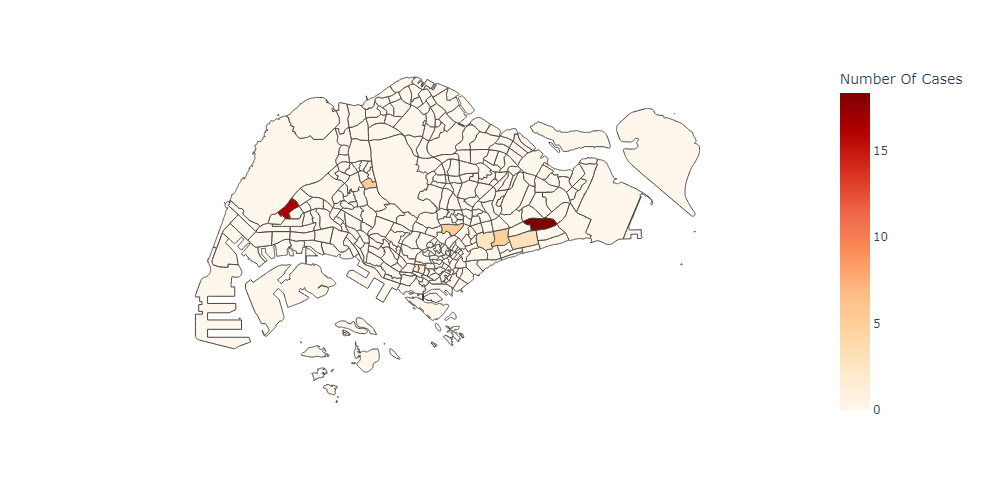

In [52]:
plot_distribution(merge_sg(date_1_pred))

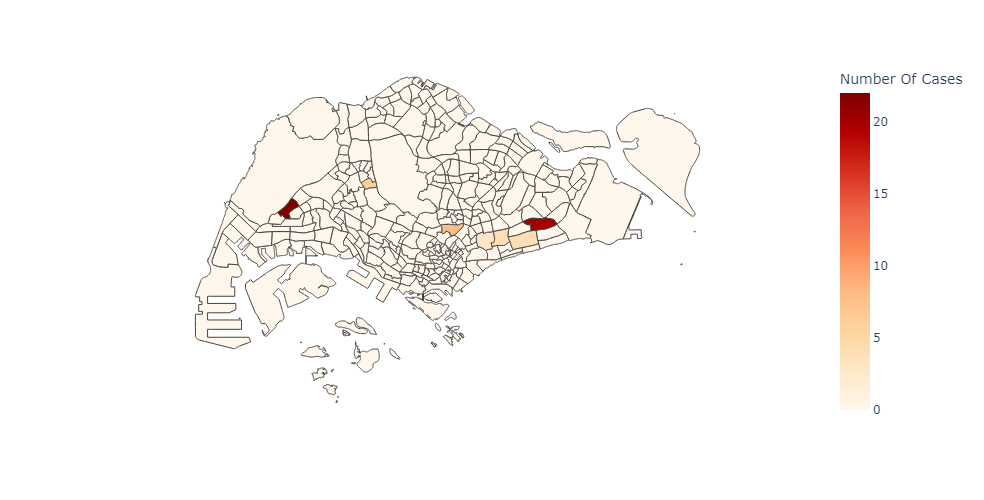

In [53]:
plot_distribution(merge_sg(date_1_true))

*Interpretation: Comparing the geographic distribution of our predictions to the true values, we observe that our predictions identify the exact same hotspot zones as the true values.* 

## Predict the second week of test data

In [54]:
#Test data move forward as 1 week
df_test = df_test_2[df_test_2[date_col] > '2018-04-23']

In [55]:
#Combine the train data with the test data with null target value
df_all = pd.concat([df_train, date_1_true, df_test], axis=0)

**Below is the same process as the 1st week prediction**

In [56]:
df_all['year'] = df_all[date_col].dt.year
df_all['month'] = df_all[date_col].dt.month
df_all['scale'] = (df_all[date_col] - df_all[date_col].min()).dt.days
df_all['scale'] = df_all['scale'].factorize()[0]

In [57]:
for i in LAGS:
    df_all[f'lags({i})'] = df_all.groupby('OBJECTID')[target].shift(i)

In [58]:
df_all = df_all.drop(columns=[date_col])
df_all[cat_cols] = df_all[cat_cols].astype('category')

In [59]:
#First and second week of the train data not used due to move forward 1 week
df_all = df_all[(df_all['scale'] != 0) & (df_all['scale'] != 1)]

In [60]:
for i in LAGS:
    df_all[f'lags({i})'].fillna(0,inplace=True)

In [61]:
#The last scale value of the train data is scale_start_test - 1 (scale_start_test+1 due to move forward 1 week)
scale_start_test = scale_start_test+1
scale_last = scale_start_test-1

In [62]:
study = optuna.create_study(direction='minimize', study_name='Regressor')
study.optimize(lgb_objective, n_trials=30, show_progress_bar=True)

[I 2023-04-25 00:41:09,076] A new study created in memory with name: Regressor


  0%|          | 0/30 [00:00<?, ?it/s]

[LightGBM] [Warning] lambda_l1 is set=8.754192286667074, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.754192286667074
[LightGBM] [Warning] lambda_l2 is set=3.3332044282633175, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.3332044282633175
[LightGBM] [Warning] min_data_in_leaf is set=165, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=165
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200
[I 2023-04-25 00:41:10,257] Trial 0 finished with value: 31.793461372516635 and parameters: {'colsample_bytree': 0.956373451399307, 'colsample_bynode': 0.7970492136417717, 'max_depth': 6, 'learning_rate': 0.028296960419600947, 'lambda_l1': 8.754192286667074, 'lambda_l2': 3.3332044282633175, 'num_leaves': 682, 'min_data_in_leaf': 165}. Best is trial 0 with value: 31.793461372516635.
[LightGBM] [Warning] lambda_l1 is set=2.2428097687347406, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.

In [63]:
study.best_value

23.271062229843352

In [64]:
study.best_params

{'colsample_bytree': 0.8404762053286983,
 'colsample_bynode': 0.6941692036727498,
 'max_depth': 5,
 'learning_rate': 0.09836842346415464,
 'lambda_l1': 1.6697111913588079,
 'lambda_l2': 3.560938277694059,
 'num_leaves': 595,
 'min_data_in_leaf': 35}

In [65]:
#Take the best params for the prediction (Note that the best params may vary between each run of the notebook)
params = {
    'n_iter': 200,
    'verbosity': -1,
    'objective': 'l1',
    'random_state': 42,
    'extra_trees': True,
    'colsample_bytree': 0.9781399059604393,
    'colsample_bynode': 0.9004978027091279,
    'max_depth': 8,
    'learning_rate': 0.09625850895385125,
    'lambda_l1': 1.1286921779300758,
    'lambda_l2': 0.1683951144036182,
    'num_leaves': 624,
    'min_data_in_leaf': 5}

model = lgb.LGBMRegressor(**params)

In [66]:
X, y   = df_all.drop(columns=[target]), df_all[target]
X_test, y_test = X[y.isnull()], y[y.isnull()]

train_times = list(range(scale_last))

X_train = X[X['scale'].isin(train_times)]
y_train = y[X['scale'].isin(train_times)]

if SMAPE_ENABLED:
    y_train = to_percent(X_train, y_train)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)

if SMAPE_ENABLED:
    y_pred = from_percent(X_test, y_pred)
    
df_test.loc[y_pred.index, target] = y_pred

[LightGBM] [Warning] lambda_l1 is set=1.1286921779300758, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1286921779300758
[LightGBM] [Warning] lambda_l2 is set=0.1683951144036182, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1683951144036182
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200


In [67]:
X, y   = df_all.drop(columns=[target]), df_all[target]
valid_times = list(range(scale_start_test-45, scale_start_test)) #Take 30% of train data as valid weeks
results = []

for valid_time in valid_times:
    train_times = list(range(valid_time))
    
    X_train = X[X['scale'].isin(train_times)]
    X_valid = X[X['scale'].isin([valid_time])]

    y_train = y[X['scale'].isin(train_times)]
    y_valid = y[X['scale'].isin([valid_time])]
    
    if SMAPE_ENABLED:
        y_train = to_percent(X_train, y_train)

    model.fit(X_train, y_train)
    y_pred = model.predict(X_valid)

    if SMAPE_ENABLED:
        y_pred = from_percent(X_valid, y_pred)
        
    X_valid['y_true'] = y_valid
    X_valid['y_base'] = X_valid['lags(1)']
    X_valid['y_pred'] = y_pred
    
    results.append(X_valid[['scale', 'month', 'SUBZONE_N','PLN_AREA_N','REGION_N', 'OBJECTID', 'y_true', 'y_base', 'y_pred']])
    
df_record = pd.concat(results, axis=0)
df_record.head()

[LightGBM] [Warning] lambda_l1 is set=1.1286921779300758, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1286921779300758
[LightGBM] [Warning] lambda_l2 is set=0.1683951144036182, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1683951144036182
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200
[LightGBM] [Warning] lambda_l1 is set=1.1286921779300758, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.1286921779300758
[LightGBM] [Warning] lambda_l2 is set=0.1683951144036182, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1683951144036182
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] num_iterations is set=200, n_iter=200 will be ignored. Current value: num_iterations=200
[Light

,scale,month,SUBZONE_N,PLN_AREA_N,REGION_N,OBJECTID,y_true,y_base,y_pred
3525,106,6,PASIR PANJANG 1,QUEENSTOWN,CENTRAL REGION,28,2.0,2.0,2.018731
3526,106,6,LITTLE INDIA,ROCHOR,CENTRAL REGION,65,2.0,3.0,2.714387
3527,106,6,TEBAN GARDENS,JURONG EAST,WEST REGION,136,18.0,14.0,24.164835
3528,106,6,TOA PAYOH CENTRAL,TOA PAYOH,CENTRAL REGION,174,2.0,1.0,0.972919
3529,106,6,TAMAN JURONG,JURONG WEST,WEST REGION,189,5.0,4.0,6.445101


In [68]:
base_err = df_record.groupby('OBJECTID').apply(lambda x: smape(x.y_true, x.y_base))
pred_err = df_record.groupby('OBJECTID').apply(lambda x: smape(x.y_true, x.y_pred))

blacklist = base_err[(base_err + 1e-3) < pred_err].index

print(f'Avg SMAPE(model): {pred_err.mean():.3f}')
print(f'Avg SMAPE(base): {base_err.mean():.3f}')
print(len(blacklist))

Avg SMAPE(model): 33.885
Avg SMAPE(base): 35.557
42


In [69]:
idx = df_test[df_test['OBJECTID'].isin(blacklist)].index

df_test.loc[idx, target] = df_all.loc[idx, 'lags(1)']

In [70]:
df_test

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
3799,2018-04-30,121,4.684953,2.0,FRANKEL,BEDOK,EAST REGION
3800,2018-04-30,142,4.423930,2.0,TAMPINES EAST,TAMPINES,EAST REGION
3801,2018-04-30,160,35.009583,167.0,YUNNAN,JURONG WEST,WEST REGION
3802,2018-04-30,173,25.859665,42.0,BEDOK NORTH,BEDOK,EAST REGION
3803,2018-04-30,181,7.404723,4.0,BALESTIER,NOVENA,CENTRAL REGION
...,...,...,...,...,...,...,...
4176,2018-12-31,234,0.000000,6.0,YIO CHU KANG WEST,ANG MO KIO,NORTH-EAST REGION
4177,2018-12-31,252,0.000000,4.0,LORONG AH SOO,HOUGANG,NORTH-EAST REGION
4178,2018-12-31,274,0.000000,8.0,YISHUN WEST,YISHUN,NORTH REGION
4179,2018-12-31,280,0.000000,4.0,MIDVIEW,WOODLANDS,NORTH REGION


### Result Analysis

In [71]:
apply_func = lambda x: pd.Series([smape(x.y_true, x.y_base), smape(x.y_true, x.y_pred)])

#### SMAPE by timeline (scale)

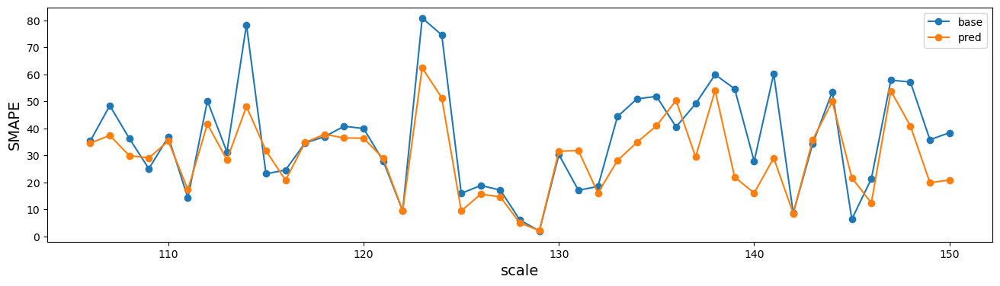

In [72]:
compare_by = 'scale'
data = df_record.groupby(compare_by).apply(apply_func)

plt.figure(figsize=(16, 4))
plt.xlabel(compare_by, fontsize=14)
plt.ylabel('SMAPE', fontsize=14)
plt.plot(data, marker='o')
plt.legend(['base', 'pred'])
plt.show()

*Interpretation: When comparing the SMAPE value of our predictions to the baseline lag(1), we observe that our prediction has a lower SMAPE value than the baseline for most weeks. However, similar to the first week prediction, the range of SMAPE values varies widely ranging from 4% to 64%.* 

#### Geographic analysis

In [73]:
date_2_pred = df_test[df_test['Date']=='2018-04-30']
date_2_pred

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
3799,2018-04-30,121,4.684953,2.0,FRANKEL,BEDOK,EAST REGION
3800,2018-04-30,142,4.423930,2.0,TAMPINES EAST,TAMPINES,EAST REGION
3801,2018-04-30,160,35.009583,167.0,YUNNAN,JURONG WEST,WEST REGION
3802,2018-04-30,173,25.859665,42.0,BEDOK NORTH,BEDOK,EAST REGION
3803,2018-04-30,181,7.404723,4.0,BALESTIER,NOVENA,CENTRAL REGION
3804,2018-04-30,209,10.227833,20.0,DAIRY FARM,BUKIT PANJANG,WEST REGION


In [74]:
date_2_true = df_test_copy[df_test_copy['Date']=='2018-04-30']
date_2_true

,Date,OBJECTID,Number Of Cases,Recent Cases In Cluster,SUBZONE_N,PLN_AREA_N,REGION_N
3799,2018-04-30,121,2.0,2.0,FRANKEL,BEDOK,EAST REGION
3800,2018-04-30,142,2.0,2.0,TAMPINES EAST,TAMPINES,EAST REGION
3801,2018-04-30,160,44.0,167.0,YUNNAN,JURONG WEST,WEST REGION
3802,2018-04-30,173,27.0,42.0,BEDOK NORTH,BEDOK,EAST REGION
3803,2018-04-30,181,5.0,4.0,BALESTIER,NOVENA,CENTRAL REGION
3804,2018-04-30,209,15.0,20.0,DAIRY FARM,BUKIT PANJANG,WEST REGION


In [75]:
np.sqrt(mean_squared_error(date_2_true[target],date_2_pred[target]))

4.5418176649622355

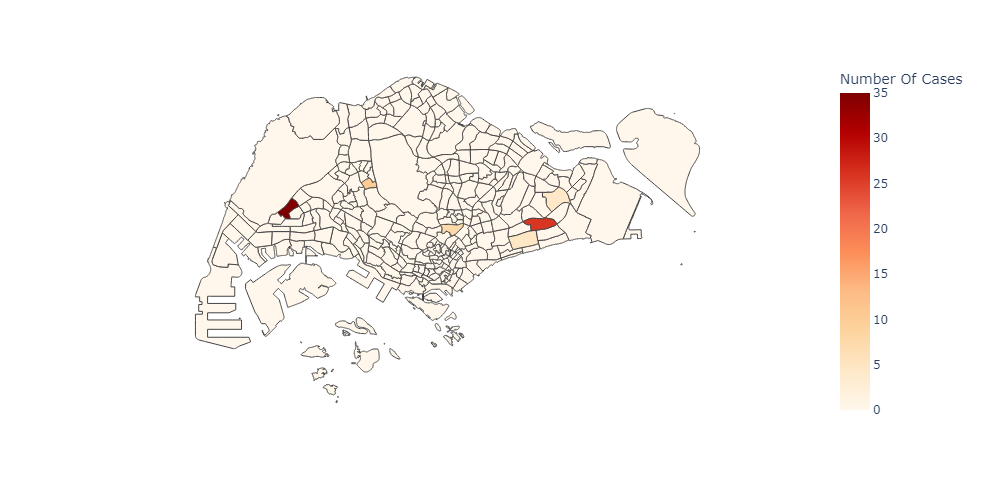

In [76]:
plot_distribution(merge_sg(date_2_pred))

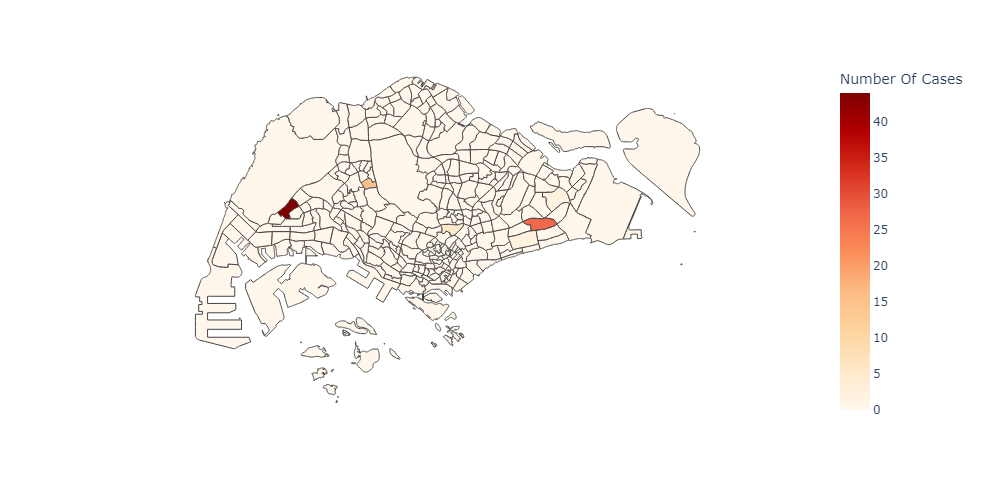

In [77]:
plot_distribution(merge_sg(date_2_true))

*Interpretation: Comparing the geographic distribution of our predictions to the true values, we observe that our predictions identify the exact same hotspot zones as the true values, similar to the first week prediction.* 

## Summary

The forecasting algorithm used processed data on dengue clusters with subzones during the geospatial EDA phase. LightGBM regressor was selected as the prediction model, and the data were split into training (80%) and testing (20%) sets for out-of-sample validation based on the time period. Within the training set, 30% of the data was further partitioned as the validation set during training. The Symmetric Mean Absolute Percentage Error (SMAPE) was calculated and compared for the prediction and baseline (lag 1) using the validation set during training.

The model will be used to predict on a weekly basis: starting with the first week of the test set, the model predicts the number of dengue cases for each subzone, then when it came to the second week, the true value of the past week should be already known and it will be used to predict the number of cases for the second week, and so on until the entire test set has been predicted. To evaluate the accuracy of the model, we selected the first and second weeks of test set and compared the predicted values to the true values for geographic analysis.

The training results demonstrated an average SMAPE of 33.2% for the first week prediction, which was lower than the baseline. Upon comparing the geographic distribution of our predictions with the true values, we noticed that our predictions identified the same hotspot zones as the true values. The second week prediction had similar results, indicating the stability of the model. However, based on the SMAPE of the validation set during training, we observed that certain weeks had a significantly large prediction error. This indicates that the model with autoregression alone may not be sufficient for long-term predictions. Additional data with more features that can better describe the target variable are required to improve the model's accuracy and reduce its variance.